In [1]:
# --- Baseline packages ---
import numpy as np
import pandas as pd
pd.set_option('display.max_columns', None)

# --- Statistical packages ---
from sklearn.preprocessing import MultiLabelBinarizer

# --- Visualisation packages ---
import matplotlib.pyplot as plt
plt.rcParams.update({'font.size': 8})
import seaborn as sns
import altair as alt

# --- Utility packages ---
import os
import sys
import joblib
import json

# --- Helper functions ---
sys.path.append(os.path.abspath('../src'))
import ecg_utils

# **5.0.** Preliminaries

In [2]:
# Get runtime.
device = ecg_utils.check_runtime_device()

# Set global seeds.
ecg_utils.set_global_seeds(seed_num=42)

# Label encoder.
rhythm_encoder_path = os.path.join("..", "..", "data", "metadata", "rhythm_encoders_dict.joblib")
rhythm_encoders = joblib.load(rhythm_encoder_path)
l1_rhythm_encoder = rhythm_encoders['rhythm_l1_enc']

# Identify relevant folder.
main_data_dir = os.path.join("..", "..", 'data')
project_dir = os.path.join("..")
final_results_dir = os.path.join("..", "final-results")

# Get consolidated final results.
output_filepath = os.path.join("..", "final-results", "analysis_df.csv")
analysis_df = pd.read_csv(output_filepath)

# Get metadata.
clean_metadata_path = os.path.join(main_data_dir, "metadata", "patient_diagnostics_clean.csv")
meta_df = pd.read_csv(clean_metadata_path)

Runtime type: mps
Global seed for torch set.
Global seed for numpy and python's inbuilt RNG set.


# **5.1.** RO1: Vision-based Models for Arrhythmia Prediction

### **5.1.1.** Deployment-relevant Metrics Comparison

In [3]:
def _create_point_chart(df, x_var, x_label, y_var, y_label, c_var, c_label, s_var, s_label):
    point_chart = alt.Chart(df).mark_point(
        size=120,
        filled=True
    ).encode(
        x=alt.X(x_var, title=x_label),
        y=alt.Y(y_var, title=y_label, scale=alt.Scale(domain=[0.9, 1.0])),
        color=alt.Color(
            c_var, title=c_label,
            legend=alt.Legend(orient='bottom', direction='vertical'),
            scale=alt.Scale(scheme='set2')
        ),
        shape=alt.Shape(
            s_var, title=s_label,
            legend=alt.Legend(orient='bottom', direction='vertical'),
            scale=alt.Scale(range=['circle', 'cross'])
        )
    )
    return point_chart

def _create_line_chart(df, x_var, x_label, y_var, y_label, c_var, c_label):
    line_chart = alt.Chart(df).mark_line().encode(
        x=alt.X(x_var, title=x_label),
        y=alt.Y(y_var, title=y_label, scale=alt.Scale(domain=[0.9, 1.0])),
        color=alt.Color(
            c_var, title=c_label,
            legend=None,
            scale=alt.Scale(scheme='set2')
        ),
        strokeDash=alt.value([4, 2]),
        strokeWidth=alt.value(1)
    )
    return line_chart

def create_score_plot(df, x_var, x_label, dataset_config, dataset_type, metric_name, label_name):
    cond1 = df['dataset_config']==dataset_config
    cond2 = df['dataset_type']==dataset_type
    cond3 = df['metric_name']==metric_name
    cond4 = df['label_name']==label_name
    subset_cond = cond1 & cond2 & cond3 & cond4
    subset_df = df[subset_cond].copy()

    metric_dict = {'f1': 'F1 Score', 'accuracy': 'Accuracy Score'}
    label_dict = {'macro_avg': 'Macro Average', 'AFIB': 'AFIB', 'SB': 'SB', 'SR': 'SR', 'GSVT': 'GSVT'}

    point_chart = _create_point_chart(subset_df,
                                      x_var, x_label,
                                      'results', f'{metric_dict[metric_name]}: {label_dict[label_name]}',
                                      'arch_family', 'Architecture Family',
                                      'arch_variant', 'Architecture Variant')
    line_chart = _create_line_chart(subset_df,
                                    x_var, x_label,
                                    'results', f'{metric_dict[metric_name]}: {label_dict[label_name]}',
                                    'arch_family', 'Architecture Family')
    chart_combine = (point_chart + line_chart).resolve_legend(color='independent', shape='independent')
    return chart_combine

In [4]:
chart_num_param = create_score_plot(analysis_df, 'total_params', 'Total No. of Parameters', 'config1', 'test', 'f1', 'macro_avg')
chart_model_size = create_score_plot(analysis_df, 'total_size_mb', 'Total Model Size (MB)', 'config1', 'test', 'f1', 'macro_avg')
chart_mac_size = create_score_plot(analysis_df, 'mac_gb', 'Multiply-Accumulate (MAC) Operations (GB)', 'config1', 'test', 'f1', 'macro_avg')

chart1 = alt.hconcat(chart_num_param, chart_model_size, chart_mac_size)
chart1

alt.HConcatChart(...)

### **5.1.2.** Accuracy-Resources Trade-off

In [5]:
filtered_df = analysis_df.query(
    "dataset_config == 'config1' and dataset_type == 'test' and label_name == 'macro_avg' and metric_name == 'f1'"
).pivot(
    index = ['arch_family'],
    columns = ['arch_variant'],
    values = ['results', 'total_params', 'total_size_mb', 'mac_gb']
)

filtered_df.columns = ['_'.join(col).strip() for col in filtered_df.columns.values]

for metric_name in ['results', 'total_params', 'total_size_mb', 'mac_gb']:
    filtered_df[f'{metric_name}_diff'] = ((filtered_df[f'{metric_name}_big'] - filtered_df[f'{metric_name}_small']) * 100 / filtered_df[f'{metric_name}_small']).round(2)

filtered_df


,results_big,results_small,total_params_big,total_params_small,total_size_mb_big,total_size_mb_small,mac_gb_big,mac_gb_small,results_diff,total_params_diff,total_size_mb_diff,mac_gb_diff
arch_family,,,,,,,,,,,,
convnext,0.961176,0.948559,87570564.0,27823204.0,626.989176,243.135096,15.372426,4.463385,1.33,214.74,157.88,244.41
efficientnet,0.957454,0.954132,10702380.0,4012672.0,425.013720,124.530760,1.930015,0.413870,0.35,166.71,241.29,366.33
mobilenetv3,0.938035,0.929578,4207156.0,1521956.0,87.878648,29.325624,0.233564,0.061458,0.91,176.43,199.67,280.04
resnet,0.948581,0.953328,23516228.0,11178564.0,272.490872,85.055864,4.131703,1.823524,-0.50,110.37,220.37,126.58


# **5.2.** RO4: Contextualising Results Against Literature

In [6]:
analysis_df.query(
    "model_arch == 'convnextbase' and metric_name in ['accuracy', 'f1', 'recall', 'precision'] and dataset_type == 'test' and label_name == 'macro_avg'"
).pivot(
    columns=['metric_name'],
    index=['model_arch', 'dataset_config'],
    values='results'
).loc[:, ['accuracy', 'f1', 'recall', 'precision']].round(3)

metric_name                  accuracy     f1  recall  precision
model_arch   dataset_config                                    
convnextbase config1            0.966  0.961   0.960      0.962
             config2            0.961  0.956   0.955      0.957

# **5.3.** RO5: Saliency Maps as an Interpretability Tool

### **5.3.1.** Consolidate Models, Predictions, and Layers

##### **5.3.1.a.** Config 1 Materials

In [7]:
%%capture
# Consolidate best trained models and model predictions.
folder_list_config1 = [folder_name for folder_name in sorted(os.listdir(final_results_dir)) if not folder_name.startswith('.') if not folder_name.endswith((".csv", "_l2", "_config2_adj", ".md"))]

true_consol_config1 = {}
pred_consol_config1 = {}
pred_correct_consol_config1 = {}
model_consol_config1 = {}
for folder_name in folder_list_config1:
    model_arch = folder_name.split("_")[0]

    # Get predicted labels.
    pred_file = os.path.join(final_results_dir, folder_name, "model_retrained_predictions.json")
    with open(pred_file, 'r') as file:
        pred_contents = json.load(file) 
    temp_df = pd.DataFrame(pred_contents['test']).drop('label_probs', axis=1)
    temp_df['pred_correct'] = temp_df['true_labels'] == temp_df['pred_labels']

    true_consol_config1[model_arch] = temp_df.true_labels
    pred_consol_config1[model_arch] = temp_df.pred_labels
    pred_correct_consol_config1[model_arch] = temp_df.pred_correct

    # Get best trained model.
    model_state_dict_path = os.path.join(final_results_dir, folder_name, "best_model_retrained.pth")
    cnn_model = ecg_utils.get_cnn_model(model_arch, 4, freezeBackbone=False, stateDictPath=model_state_dict_path)
    cnn_model = cnn_model.eval()
    model_consol_config1[model_arch] = cnn_model

# True labels dataframe (for sanity check).
true_df_config1 = pd.DataFrame(true_consol_config1)

# Predicted labels dataframe.
pred_df_config1 = pd.DataFrame(pred_consol_config1)

# Dataframe on whether predictions were correct or not.
pred_correct_df_config1 = pd.DataFrame(pred_correct_consol_config1)
pred_correct_df_config1['correct_total'] = pred_correct_df_config1.sum(axis=1)
pred_correct_df_config1['true_labels'] = temp_df['true_labels']

# Select layers to use for Grad-CAM visualisation.
layer_dict = {
    'convnextbase': model_consol_config1['convnextbase'].features[7][-1],
    'convnexttiny': model_consol_config1['convnexttiny'].features[7][-1],
    'efficientnetb0': model_consol_config1['efficientnetb0'].features[8],
    'efficientnetb3': model_consol_config1['efficientnetb3'].features[8],
    'mobilenetv3large': model_consol_config1['mobilenetv3large'].features[16],
    'mobilenetv3small': model_consol_config1['mobilenetv3small'].features[12],
    'resnet18':model_consol_config1['resnet18'].layer4[-1],
    'resnet50':model_consol_config1['resnet50'].layer4[-1]
}

##### **5.3.1.b.** Config 2 Materials

In [8]:
%%capture
# Consolidate best trained models and model predictions.
folder_list_config2 = [folder_name for folder_name in sorted(os.listdir(final_results_dir)) if not folder_name.startswith('.') if not folder_name.endswith((".csv", "_l2", "_config1_adj", ".md"))]

true_consol_config2 = {}
pred_consol_config2 = {}
pred_correct_consol_config2 = {}
model_consol_config2 = {}
for folder_name in folder_list_config2:
    model_arch = folder_name.split("_")[0]

    # Get predicted labels.
    pred_file = os.path.join(final_results_dir, folder_name, "model_retrained_predictions.json")
    with open(pred_file, 'r') as file:
        pred_contents = json.load(file) 
    temp_df = pd.DataFrame(pred_contents['test']).drop('label_probs', axis=1)
    temp_df['pred_correct'] = temp_df['true_labels'] == temp_df['pred_labels']

    true_consol_config2[model_arch] = temp_df.true_labels
    pred_consol_config2[model_arch] = temp_df.pred_labels
    model_consol_config2[model_arch] = temp_df.pred_correct

    # Get best trained model.
    model_state_dict_path = os.path.join(final_results_dir, folder_name, "best_model_retrained.pth")
    cnn_model = ecg_utils.get_cnn_model(model_arch, 4, freezeBackbone=False, stateDictPath=model_state_dict_path)
    cnn_model = cnn_model.eval()
    model_consol_config2[model_arch] = cnn_model

# True labels dataframe (for sanity check).
true_df_config2 = pd.DataFrame(true_consol_config2)

# Predicted labels dataframe.
pred_df_config2 = pd.DataFrame(pred_consol_config2)

# Dataframe on whether predictions were correct or not.
pred_correct_df_config2 = pd.DataFrame(pred_correct_consol_config2)
pred_correct_df_config2['correct_total'] = pred_correct_df_config2.sum(axis=1)
pred_correct_df_config2['true_labels'] = temp_df['true_labels']
pred_correct_df_config2['prefix'] = pred_correct_df_config2.reset_index()['index'].apply(lambda x: 'v1_std' if (x%2)==0 else 'v2_std')
pred_correct_df_config2['main_index'] = pred_correct_df_config2.reset_index()['index'].apply(lambda x: x//2)

# Select layers to use for Grad-CAM visualisation.
layer_dict_config2 = {
    'convnextbase': model_consol_config2['convnextbase'].features[7][-1],
    'resnet18':model_consol_config2['resnet18'].layer4[-1]
}

# Dataframe grouped by image name.
grouped_df_config2 = pd.DataFrame(pred_correct_df_config2.groupby(['main_index', 'true_labels'])['correct_total'].sum()).reset_index()

### **5.3.2.** Helper Functions

In [9]:
model_arch_list = ['mobilenetv3small', 'mobilenetv3large', 'resnet18', 'resnet50', 'efficientnetb0', 'efficientnetb3', 'convnexttiny', 'convnextbase']
model_arch_name = ['MobileNetV3-small', 'MobileNetV3-large', 'ResNet-18', 'ResNet-50', 'EfficientNet-B0', 'EfficientNet-B3', 'ConvNeXt-tiny', 'ConvNeXt-base']
arch_name_dict = {arch:name for arch, name in zip(model_arch_list, model_arch_name)}

def plot_all_model_map(data_idx, label_num, target_class=None):
    label_name = l1_rhythm_encoder.inverse_transform([label_num]).item()

    fig, axs = plt.subplots(4, 2, figsize=(30,25))
    for i, model_arch in enumerate(model_arch_list):
        guided_gradcam_img, img_label, pred_label, img_name = ecg_utils.generate_guidedgradcam_image(
            main_data_dir,
            model_arch,
            "config1_adj",
            "test",
            data_idx,
            model_consol_config1[model_arch],
            layer_dict[model_arch],
            adj_viz_alpha=0.6,
            adj_viz_bright=0,
            device="cpu",
            skew=True,
            target_class=target_class
        )

        row_num = i // 2
        col_num = i % 2
        axs[row_num, col_num].imshow(guided_gradcam_img)
        axs[row_num, col_num].axis("off")
        axs[row_num, col_num].set_title(f"{arch_name_dict[model_arch]}", fontsize=20, pad=15)

    fig.tight_layout(h_pad=0.97)
    plt.show()


def plot_config2_map(main_data_idx, label_num, model_arch, target_class=None):
    label_name = l1_rhythm_encoder.inverse_transform([label_num]).item()

    fig, axs = plt.subplots(1, 2, figsize=(15,5))
    for j, data_idx in enumerate(pred_correct_df_config2[pred_correct_df_config2['main_index'] == main_data_idx].index):
        guided_gradcam_img, img_label, pred_label, img_name = ecg_utils.generate_guidedgradcam_image(
            main_data_dir,
            model_arch,
            "config2_adj",
            "test",
            data_idx,
            model_consol_config2[model_arch],
            layer_dict_config2[model_arch],
            adj_viz_alpha=0.6,
            adj_viz_bright=0,
            device="cpu",
            skew=True,
            target_class=target_class
        )

        axs[j].imshow(guided_gradcam_img)
        axs[j].axis("off")
        axs[j].set_title(f"{arch_name_dict[model_arch]}  |  Layout {j+1}", fontsize=14, pad=15)

    fig.tight_layout(h_pad=0.97)
    plt.show()

### **5.3.3.** Semantically Meaningful Activations

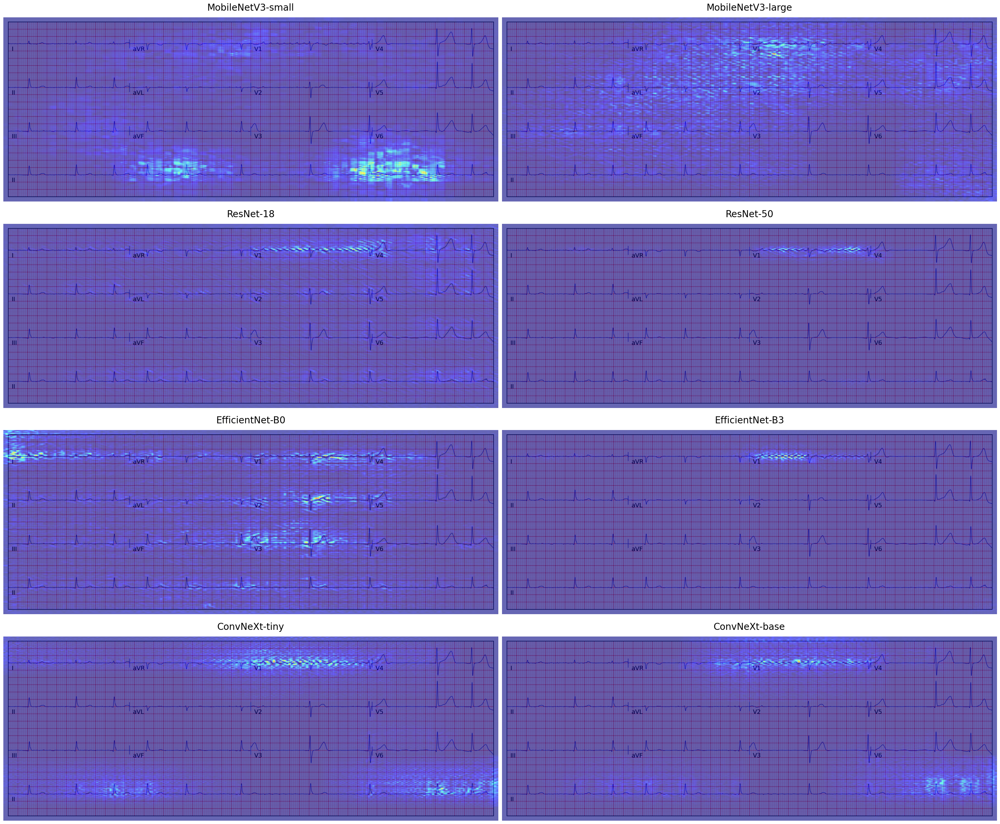

In [10]:
label_num = 0
data_idx = 0
plot_all_model_map(data_idx, label_num)

### **5.3.4.** Understanding Model Failure

##### **5.3.4.a.** Misclassified Saliency Map

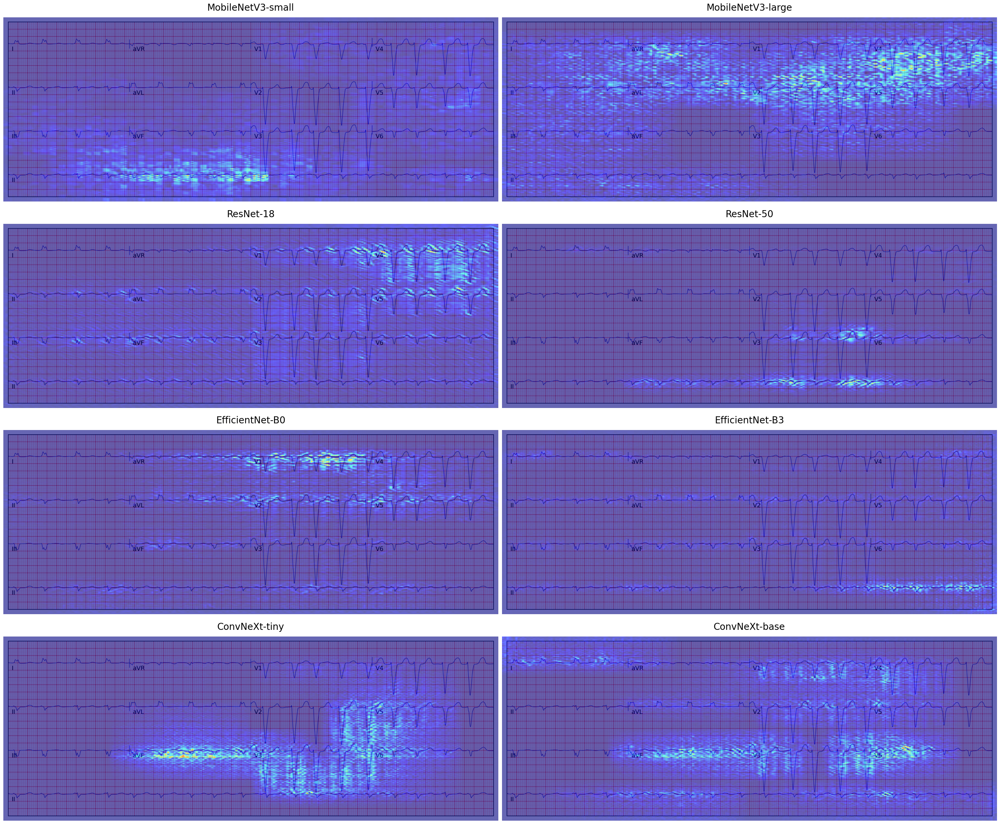

In [11]:
label_num = 0
data_idx = 889
plot_all_model_map(data_idx, label_num)

##### **5.3.4.b.** Beat Statistics

In [12]:
splitArray = meta_df['Beat'].str.split()

mlb = MultiLabelBinarizer()
oneHot = mlb.fit_transform(splitArray)
oneHot_df = pd.DataFrame(oneHot, columns=mlb.classes_)
beat_df = pd.concat([meta_df[['Rhythm_L1', 'BeatCount']], oneHot_df], axis=1)
beat_long = beat_df.melt(id_vars='Rhythm_L1', value_vars=beat_df.columns.drop(['Rhythm_L1', 'BeatCount']), var_name='Beat', value_name='Count')

rhythm_tot = meta_df.groupby('Rhythm_L1')['Rhythm_L1'].value_counts()
beat_pivot = pd.pivot_table(beat_long, values='Count', index='Beat', columns='Rhythm_L1', aggfunc='sum')
beat_pivot.columns.name = None
beat_pivot['Total'] = beat_pivot.sum(axis=1)
beat_pivot['AFIB'] = beat_pivot['AFIB'] / rhythm_tot.AFIB
beat_pivot['GSVT'] = beat_pivot['GSVT'] / rhythm_tot.GSVT
beat_pivot['SB'] = beat_pivot['SB'] / rhythm_tot.SB
beat_pivot['SR'] = beat_pivot['SR'] / rhythm_tot.SR
beat_pivot['Total'] = beat_pivot['Total'] / np.sum(rhythm_tot)

In [13]:
beat_pivot.sort_values('AFIB', ascending=False).loc[['ALS', "LBBB", "CR"], 'AFIB']

Beat
ALS     0.062669
LBBB    0.019387
CR      0.010370
Name: AFIB, dtype: float64

### **5.3.5.** Inconsistent Activations

##### **5.3.5.a.** Inconsistency Across Models

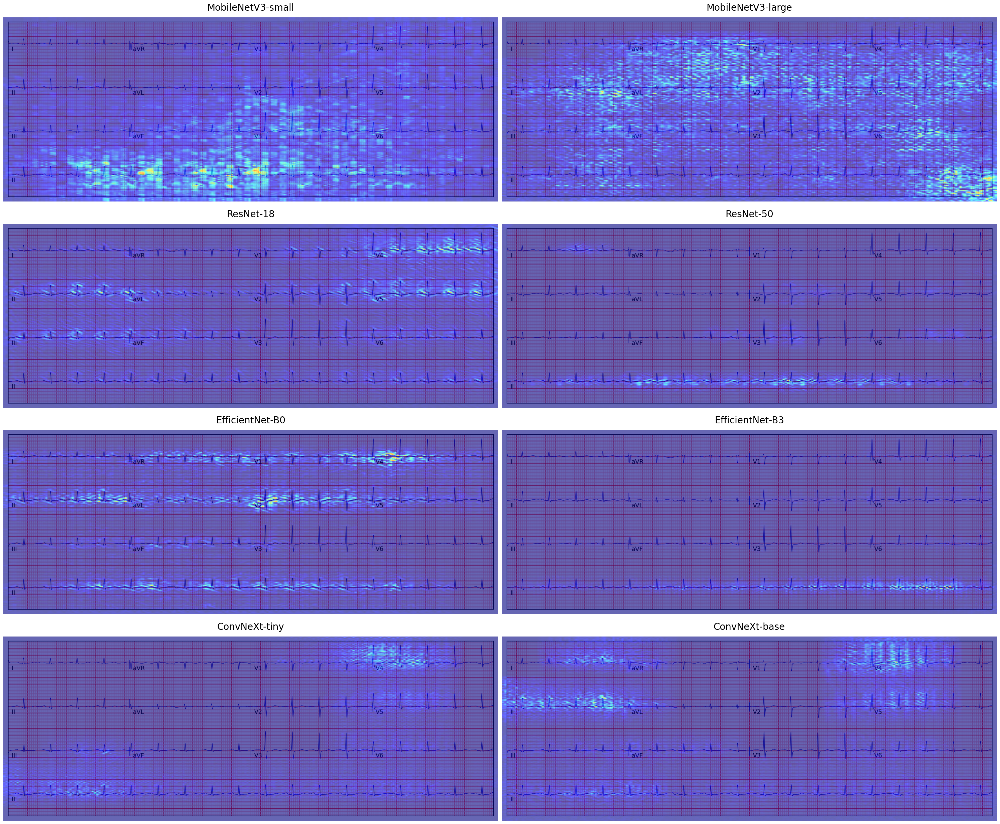

In [14]:
label_num = 1
data_idx = 4
plot_all_model_map(data_idx, label_num)

##### **5.3.5.b.** Inconsistency Within A Model

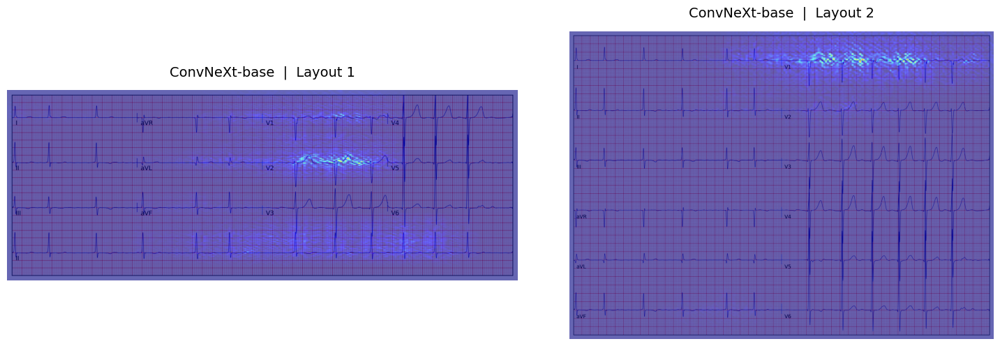

In [15]:
label_num = 0
data_idx = 71
plot_config2_map(data_idx, label_num, 'convnextbase')